# Air_Pollution Regression Problem

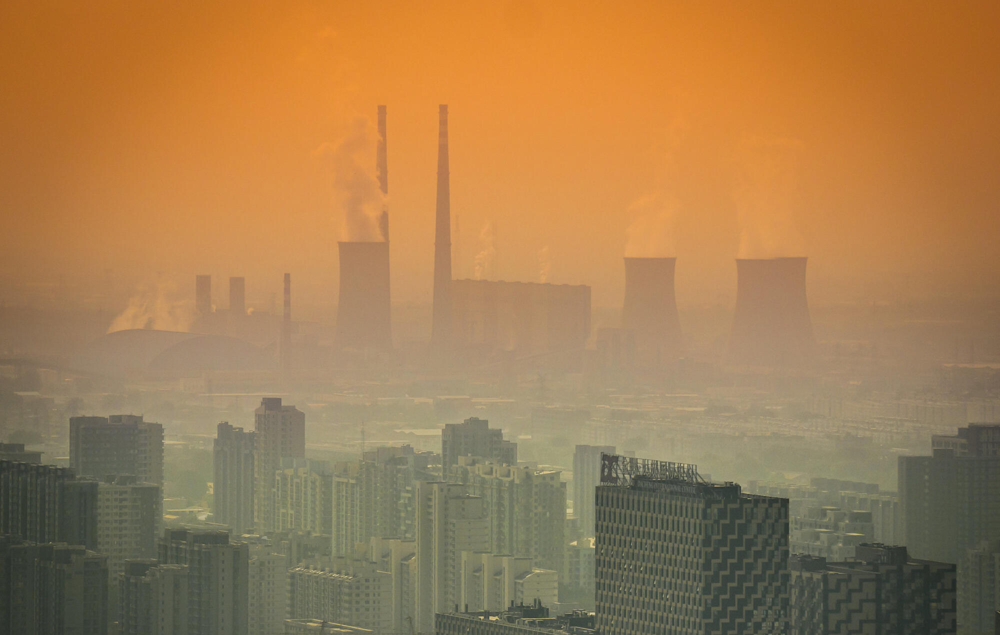

# Introduction: 

    Air is one of the primary need for the living being and we are as a humans, breathe every minute of our life and that is why the quality of the air is crusial factor for the comfort and healthy living of each individual.

    In this project, we decided to work with a dataset containing reports on the weather and the level of pollution each hour for 5 years at the US Embassy in Beijing, China. The level of pollution is represented by the concentration of PM2.5 which is airborne particulate matter. 

# What is PM2.5? 

      Airborne particulate matter (PM) is not a single pollutant, but rather is a mixture of many chemical species. It is a complex mixture of solids and aerosols composed of small droplets of liquid, dry solid fragments, and solid cores with liquid coatings. Particles vary widely in size, shape and chemical composition, and may contain inorganic ions, metallic compounds, elemental carbon, organic compounds, and compounds from the earth’s crust. Particles are defined by their diameter for air quality regulatory purposes. Fine particulate matter is defined as particles that are 2.5 microns or less in diameter (PM2.5).

# Objectives: 

    Our goals:

    1. To find insights into the weather patterns and the possible reason for pollutation rates

    2. To develop a Deep Learning model that predicts pollution levels in the next hour

    3. To develop a Deep Learning model that predicts pollution levels the next day

#  Description:  

    1. Type of problem: regression.

    2. Variables: 11 Numerical, 1 Categorical:

        1. No: row number

        2. year: the year of data in this row

        3. month: the month of data in this row

        4. day: the day of data in this row

        5. hour: The hour of data in this row

        6. DEWP: Dew Point

        7. TEMP: Temperature

        8. PRES: Pressure

        9. cbwd: Combined wind direction

        10. IWS: Cumulative wind speed

        11. Is: Cumulated hours of snow

    3. Target: PM2.5 (float):

        1. pm2.5: PM2.5 concentration

    4. Steps we made

        1. Importing a dataset

        2. EDA

        3. Feature engineering

            1. Imputation of NAN values:

                > KNNImputer

            2. Drop unnecessary variables

            3. Categorical variables encoding:

                > CountFrequencyEncoder

            4. Scaling:

                > Robust Scaler

            5. Train/test split:

                > Train - 3 years

                > Test - 2 years 

        4. Training ANN

        5. Model evaluation and result analysis

    5. Deep Learning Algorithms we used:

        > For predicting the pollution rate for the next hour:

            1. LSTM (Long-Short-Term Memory) with 2 hidden layers (100 neurons each).

            2. LSTM with 4 hidden layers (100 neurons each) + 3 Dropout layers (0.3)

        > For predicting the pollution rate for the next hour:

            1. LSTM (Long-Short-Term Memory) with 2 hidden layers (100 neurons each).

    6. Evaluation metrix we used:

        1. Mean Absolute Error (MAE)

        2. Mean Square Error (MSE)

        3. Root Mean Square Error (RMSE)

        4. R2 score

#  STEP 0: Importing Libraries  

In [1]:
#for loading & for linear algebra
import pandas as pd
import numpy as np

#for data visualization
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
pio.renderers.default = 'notebook'
import plotly.figure_factory as ff
import seaborn as sns
import scipy.stats as stats
from scipy.stats import chi2_contingency 
from plotly.offline import init_notebook_mode
from mlens.visualization import corrmat

import plotly.figure_factory as ff
from statistics import stdev
from wordcloud import WordCloud
init_notebook_mode(connected=True)
sns.set_context("notebook")
import random

#for spliting data set
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict

#for missing values imputation
import sys
from sklearn.datasets import fetch_california_housing
from sklearn.metrics import mean_squared_error
from sklearn.datasets import fetch_california_housing
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import mean_squared_error
from sklearn.impute import SimpleImputer, KNNImputer
from feature_engine.imputation import RandomSampleImputer, MeanMedianImputer, ArbitraryNumberImputer,EndTailImputer, CategoricalImputer
from math import sqrt
random.seed(0)

#for feature engineering
from sklearn.feature_extraction.text import CountVectorizer
from feature_engine.encoding import OneHotEncoder, CountFrequencyEncoder
from feature_engine.discretisation import DecisionTreeDiscretiser
from feature_engine.discretisation import EqualFrequencyDiscretiser, EqualWidthDiscretiser

#for feature selection
from feature_engine.selection import DropConstantFeatures, DropDuplicateFeatures, SmartCorrelatedSelection
from sklearn.feature_selection import SelectFromModel
from sklearn.feature_selection import RFECV, RFE


#for balancing the dataset
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler

#for feature magnitude
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler

#for Super Learner
from mlens.ensemble import SuperLearner

#for Pipelines and Column Tranformers
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer, make_column_selector

#for hyperparametres tuning
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import optuna

#libraries for Deep Learning
import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

#for matrixes for evaluating models
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

from jupyterthemes import jtplot
jtplot.style()
import absl.logging

absl.logging.set_verbosity(absl.logging.ERROR)

[MLENS] backend: threading


#  STEP 1: Importing the dataset  

    In this section, we imported the dataset using pandas library

In [2]:
data = pd.read_csv('pollution.csv')

#  STEP 2: EDA (Exploratory Data Analysis) 

    In this section, we will focus on Initial Data Exploration to get familiar with the dataset

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43824 entries, 0 to 43823
Data columns (total 13 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   No      43824 non-null  int64  
 1   year    43824 non-null  int64  
 2   month   43824 non-null  int64  
 3   day     43824 non-null  int64  
 4   hour    43824 non-null  int64  
 5   pm2.5   41757 non-null  float64
 6   DEWP    43824 non-null  int64  
 7   TEMP    43824 non-null  float64
 8   PRES    43824 non-null  float64
 9   cbwd    43824 non-null  object 
 10  Iws     43824 non-null  float64
 11  Is      43824 non-null  int64  
 12  Ir      43824 non-null  int64  
dtypes: float64(4), int64(8), object(1)
memory usage: 4.3+ MB


In [4]:
data.describe()

,No,year,month,day,hour,pm2.5,DEWP,TEMP,PRES,Iws,Is,Ir
count,43824.000000,43824.000000,43824.000000,43824.000000,43824.000000,41757.000000,43824.000000,43824.000000,43824.000000,43824.000000,43824.000000,43824.000000
mean,21912.500000,2012.000000,6.523549,15.727820,11.500000,98.613215,1.817246,12.448521,1016.447654,23.889140,0.052734,0.194916
std,12651.043435,1.413842,3.448572,8.799425,6.922266,92.050387,14.433440,12.198613,10.268698,50.010635,0.760375,1.415867
min,1.000000,2010.000000,1.000000,1.000000,0.000000,0.000000,-40.000000,-19.000000,991.000000,0.450000,0.000000,0.000000
25%,10956.750000,2011.000000,4.000000,8.000000,5.750000,29.000000,-10.000000,2.000000,1008.000000,1.790000,0.000000,0.000000
50%,21912.500000,2012.000000,7.000000,16.000000,11.500000,72.000000,2.000000,14.000000,1016.000000,5.370000,0.000000,0.000000
75%,32868.250000,2013.000000,10.000000,23.000000,17.250000,137.000000,15.000000,23.000000,1025.000000,21.910000,0.000000,0.000000
max,43824.000000,2014.000000,12.000000,31.000000,23.000000,994.000000,28.000000,42.000000,1046.000000,585.600000,27.000000,36.000000


    We can see that:
        1. dataset consist of 43,824 samples and 13 features
        2. 12 features are numerical and 1 feature is categorical types
        3. there are 4 float and 8 int types
        4. it is regression problem
        5. there are some null values in the dataset
        6. variables are not is the same dimentions

In [5]:
data

,No,year,month,day,hour,pm2.5,DEWP,TEMP,PRES,cbwd,Iws,Is,Ir
0,1,2010,1,1,0,NaN,-21,-11.0,1021.0,NW,1.79,0,0
1,2,2010,1,1,1,NaN,-21,-12.0,1020.0,NW,4.92,0,0
2,3,2010,1,1,2,NaN,-21,-11.0,1019.0,NW,6.71,0,0
3,4,2010,1,1,3,NaN,-21,-14.0,1019.0,NW,9.84,0,0
4,5,2010,1,1,4,NaN,-20,-12.0,1018.0,NW,12.97,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
43819,43820,2014,12,31,19,8.0,-23,-2.0,1034.0,NW,231.97,0,0
43820,43821,2014,12,31,20,10.0,-22,-3.0,1034.0,NW,237.78,0,0
43821,43822,2014,12,31,21,10.0,-22,-3.0,1034.0,NW,242.70,0,0
43822,43823,2014,12,31,22,8.0,-22,-4.0,1034.0,NW,246.72,0,0


## Converting variables into datetime format

In [6]:
data.index = pd.to_datetime(data[['year', 'month', 'day', 'hour']], format = '%Y %m %d %H')
data.index.name = 'Date'

## Creating new feature for data analysis

In [7]:
## new feature for analysis
data['Season'] = data['month'].map({12: 'Winter', 1: 'Winter', 2: 'Winter',
                                    3: 'Spring', 4: 'Spring', 5: 'Spring',
                                    6: 'Summer', 7: 'Summer', 8: 'Summer',
                                    9: 'Fall', 10: 'Fall', 11: 'Fall'})

## modifiying month for better understanding
data['month'] = data['month'].map({1: 'January',
                                   2: 'February',
                                   3: 'March',
                                   4: 'April',
                                   5: 'May',
                                   6: 'June',
                                   7: 'July',
                                   8: 'August',
                                   9: 'September',
                                   10: 'October',
                                   11: 'November',
                                   12: 'December'})

## Renaming the features for better interpretation

In [8]:
data = data.rename(columns = {
    'pm2.5': 'Pollution',
    'DEWP': 'Dew_point',
    'TEMP': 'Temperature',
    'PRES': 'Pressure',
    'cbwd': 'Wind_direction',
    'Iws': 'Wind_speed',
    'Is': 'Snow',
    'Ir': 'Rain'
})

data

,No,year,month,day,hour,Pollution,Dew_point,Temperature,Pressure,Wind_direction,Wind_speed,Snow,Rain,Season
Date,,,,,,,,,,,,,,
2010-01-01 00:00:00,1,2010,January,1,0,NaN,-21,-11.0,1021.0,NW,1.79,0,0,Winter
2010-01-01 01:00:00,2,2010,January,1,1,NaN,-21,-12.0,1020.0,NW,4.92,0,0,Winter
2010-01-01 02:00:00,3,2010,January,1,2,NaN,-21,-11.0,1019.0,NW,6.71,0,0,Winter
2010-01-01 03:00:00,4,2010,January,1,3,NaN,-21,-14.0,1019.0,NW,9.84,0,0,Winter
2010-01-01 04:00:00,5,2010,January,1,4,NaN,-20,-12.0,1018.0,NW,12.97,0,0,Winter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-31 19:00:00,43820,2014,December,31,19,8.0,-23,-2.0,1034.0,NW,231.97,0,0,Winter
2014-12-31 20:00:00,43821,2014,December,31,20,10.0,-22,-3.0,1034.0,NW,237.78,0,0,Winter
2014-12-31 21:00:00,43822,2014,December,31,21,10.0,-22,-3.0,1034.0,NW,242.70,0,0,Winter


In [9]:
data = data[24:]

## Distribution

In [10]:
## numerical variables
numerical = [col for col in data.columns if data[col].dtype != 'O']

## categorical variables
categorical = [col for col in data.columns if data[col].dtype == 'O']


In [11]:
def diagnostic_plots(df, variable):
    plt.figure(figsize = (12, 5))
    plt.suptitle(variable)
    
    #histogramma
    plt.subplot(1, 3, 1)
    sns.histplot(x = variable, data = df, kde = True, bins = 50)
    plt.title('histogramm')
    
    #Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist = 'norm', plot = plt)
    plt.title('Q-Q plot')
    
    #boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y = df[variable], color = 'violet')
    plt.title('boxplot')
    
    plt.show()

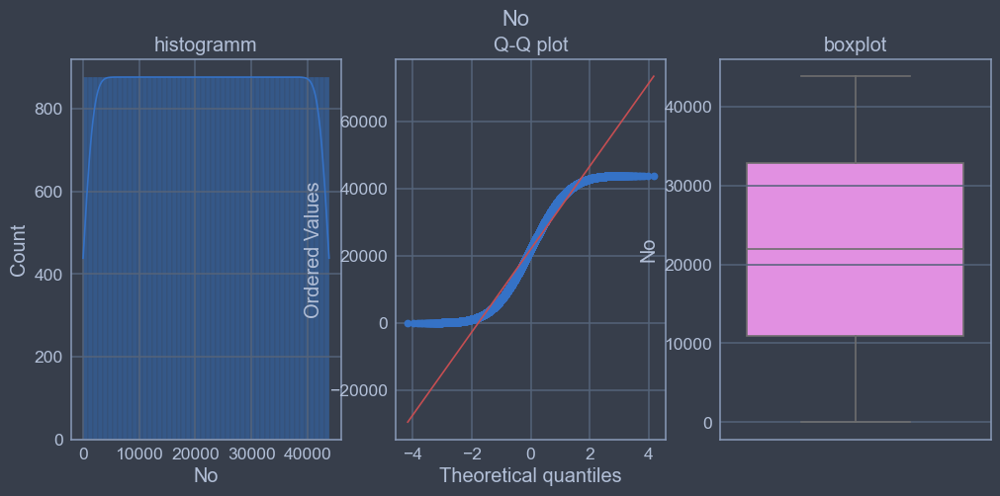

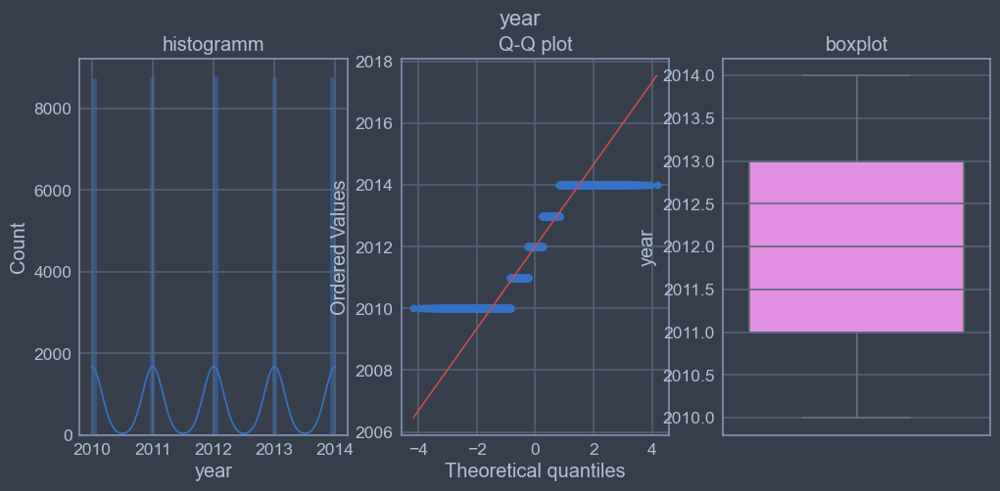

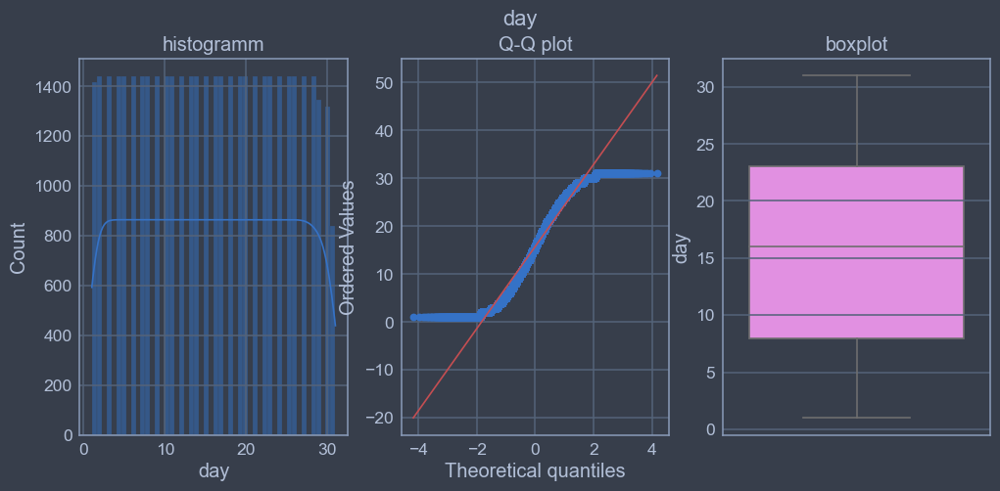

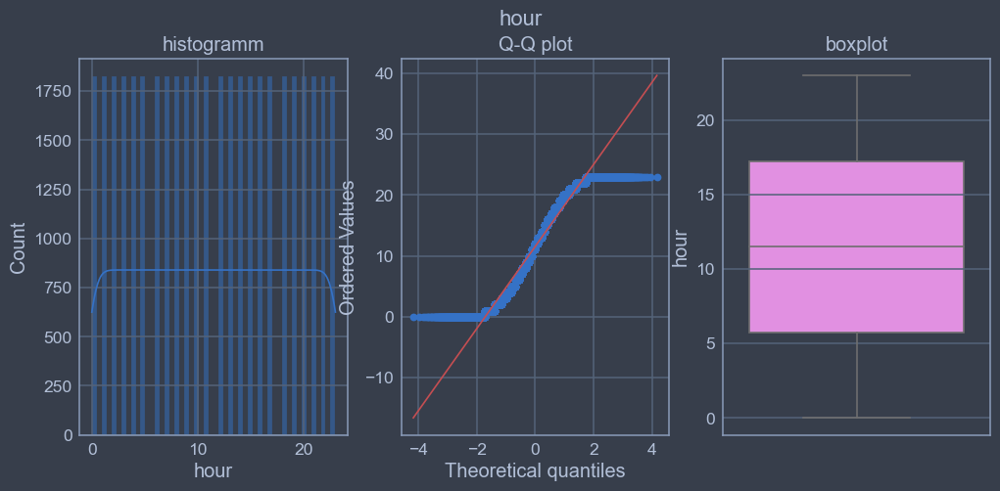

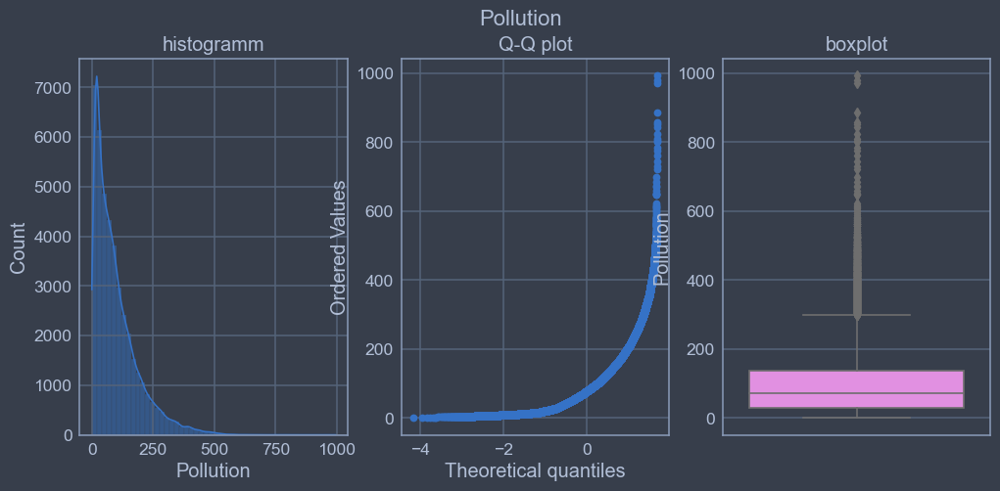

...

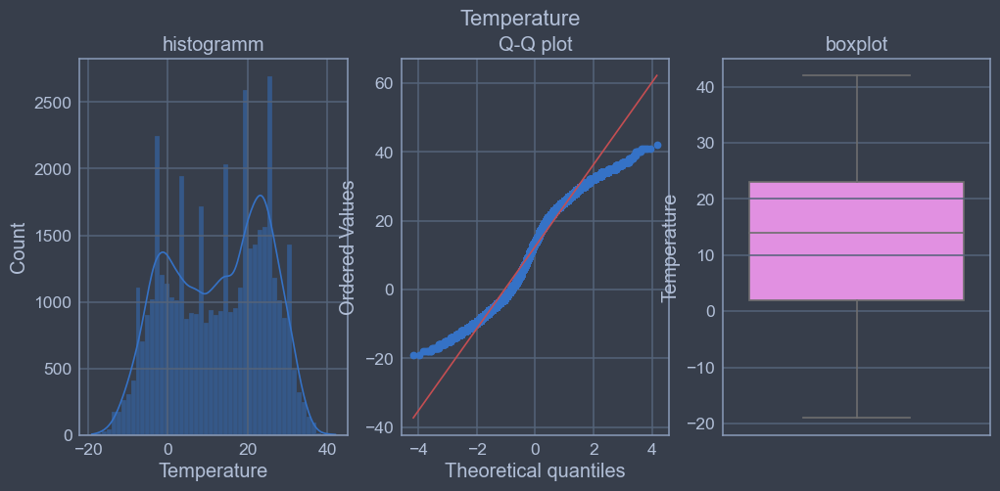

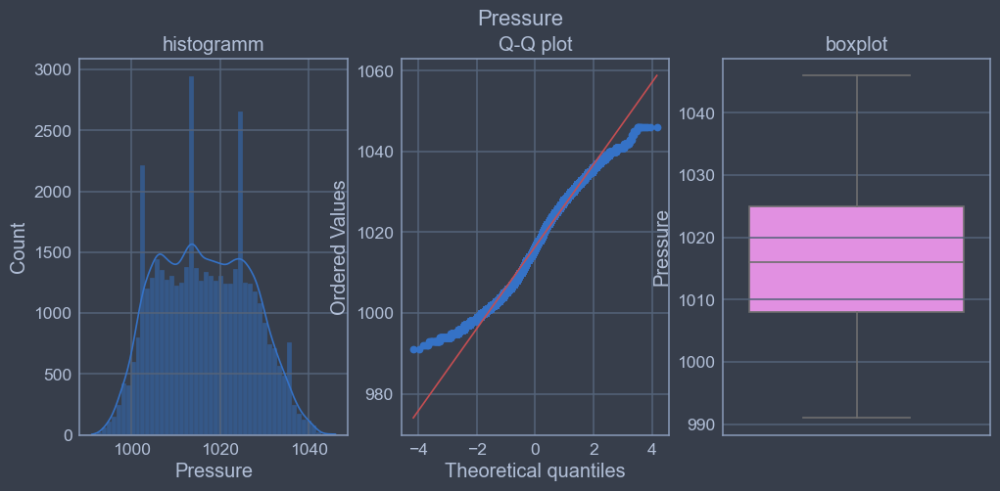

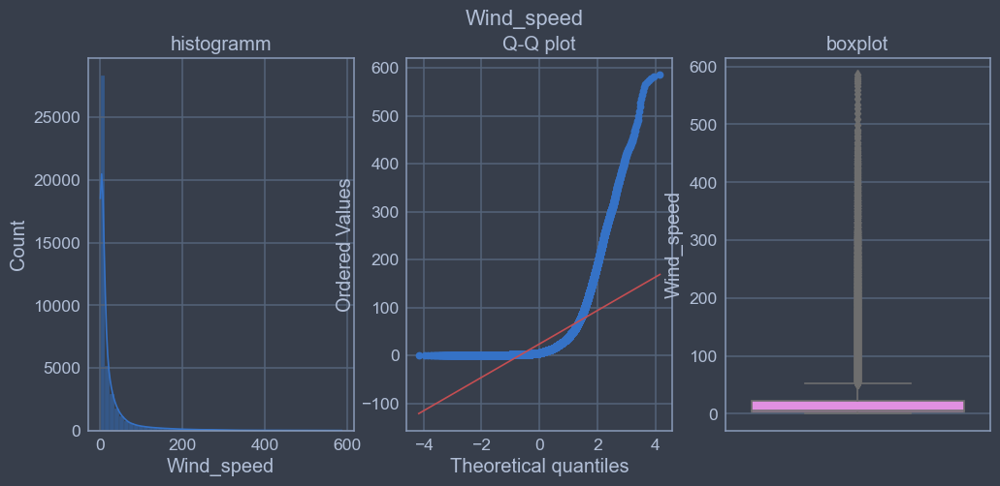

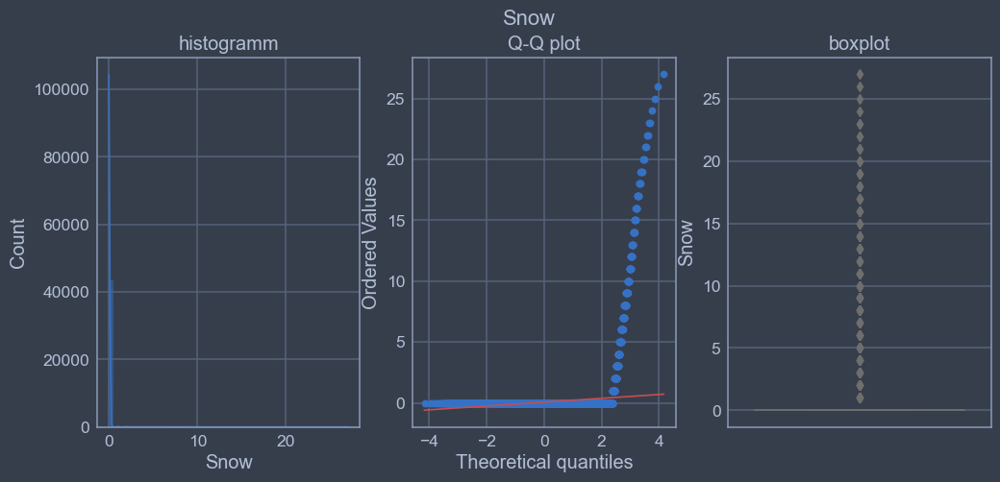

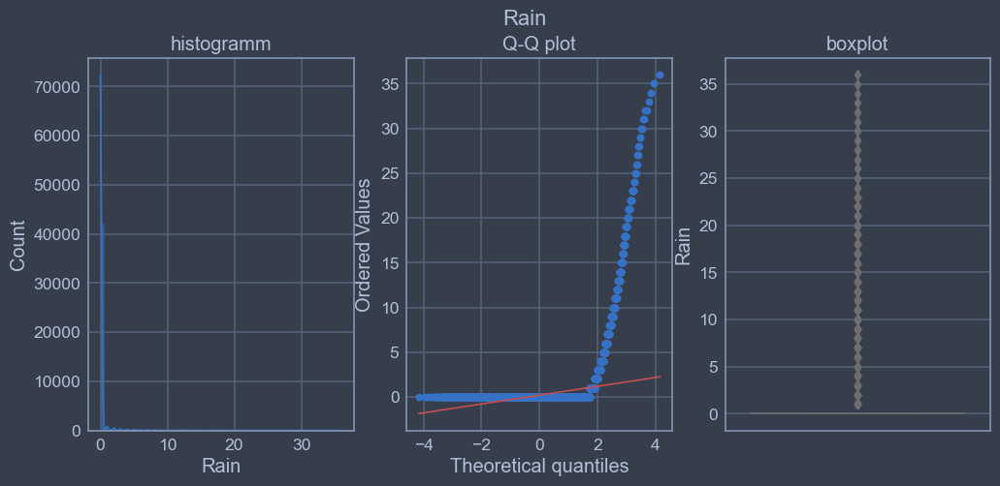

In [12]:
for col in numerical:
    diagnostic_plots(data, col)

## Correlation Matrix

C:\Users\Kim Stanislav\AppData\Local\Temp\ipykernel_25316\3625167045.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



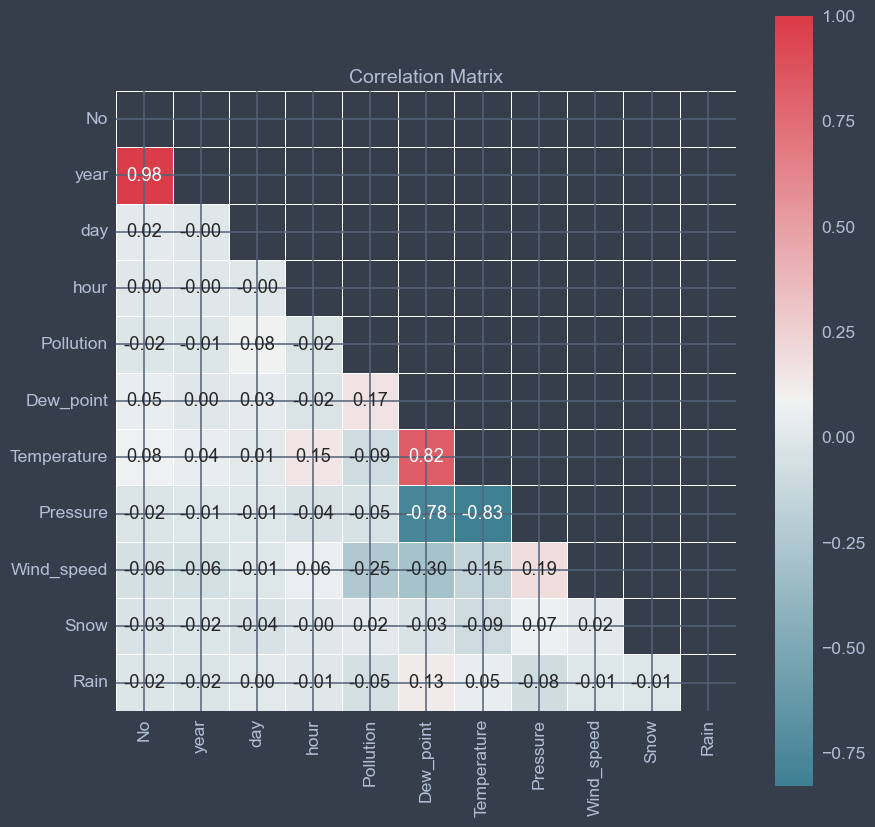

<Axes: title={'center': 'Correlation Matrix'}>

In [13]:
corrmat(data.corr(), figsize = (10, 10), inflate = False)

    We can see that the Dew_point and the temperature are highly correlated as well as a pressure 

## NaN values

In [14]:
data.isnull().sum()

No                   0
year                 0
month                0
day                  0
hour                 0
Pollution         2043
Dew_point            0
Temperature          0
Pressure             0
Wind_direction       0
Wind_speed           0
Snow                 0
Rain                 0
Season               0
dtype: int64

    We can see that only one feature has Null values

## Dividing datasets to 5 parts

In [15]:
data_2010 = data.loc['2010']
data_2011 = data.loc['2011']
data_2012 = data.loc['2012']
data_2013 = data.loc['2013']
data_2014 = data.loc['2014']

## Pollution level by Date

In [16]:
data_dict = {'2010': data_2010,
             '2011': data_2011,
             '2012': data_2012,
             '2013': data_2013,
             '2014': data_2014}

for date, data_ in data_dict.items():    
    fig = px.line(data_, y="Pollution", title = 'Pollution in {}'.format(date))
    fig.show()
    print("*********INSIGHTS*********")
    print('Mean Pollution rate in {0}: {1}'.format(date, np.round(data_['Pollution'].mean(), 2)))
    print('Max Pollution rate in {0}: {1}'.format(date, data_['Pollution'].max()))
    print('Min Pollution rate in {0}: {1}'.format(date, data_['Pollution'].min()))
    print('Highest rate of Pollution was during: {}'.format(data_.groupby('Season')['Pollution'].mean().idxmax()))
    print('Highest rate of Pollution was in: {}\n'.format(data_.groupby('month')['Pollution'].mean().idxmax()))
    print('=' * 150)

*********INSIGHTS*********
Mean Pollution rate in 2010: 104.05
Max Pollution rate in 2010: 980.0
Min Pollution rate in 2010: 1.0
Highest rate of Pollution was during: Fall
Highest rate of Pollution was in: November



*********INSIGHTS*********
Mean Pollution rate in 2011: 99.07
Max Pollution rate in 2011: 595.0
Min Pollution rate in 2011: 2.0
Highest rate of Pollution was during: Fall
Highest rate of Pollution was in: February



*********INSIGHTS*********
Mean Pollution rate in 2012: 90.55
Max Pollution rate in 2012: 994.0
Min Pollution rate in 2012: 0.0
Highest rate of Pollution was during: Winter
Highest rate of Pollution was in: January



*********INSIGHTS*********
Mean Pollution rate in 2013: 101.71
Max Pollution rate in 2013: 886.0
Min Pollution rate in 2013: 2.0
Highest rate of Pollution was during: Winter
Highest rate of Pollution was in: January



*********INSIGHTS*********
Mean Pollution rate in 2014: 97.73
Max Pollution rate in 2014: 671.0
Min Pollution rate in 2014: 2.0
Highest rate of Pollution was during: Winter
Highest rate of Pollution was in: February



    There are some interesting Insights:
        1. We can see that in 2010 and 2013 the pollution rates were the highest
        2. During first two years of report, The most polluted season was Fall, While from the 2012 to 2014, the most polluted season has changed to Winter
        3. Summer was the least polluted season during all 5 years
        4. The most polluted month were usually February or January 
        5. The pick of the pollution was in 2010 and 2012, reaching almost 1000
        6. 2012 year was least polluted year, having the smallest mean

## Temperature in accordance to Dew_point

In [17]:
fig_1 = px.density_heatmap(data, x = 'Temperature', y = 'Dew_point', title= 'Relation of Temperature and Dew_point')
fig_1.show()
fig_2 = px.scatter(data, x = 'Temperature', y = 'Dew_point',  title= 'Relation of Temperature and Dew_point')
fig_2.show()

    We can see the clear relation of Temperature and Dew_point. The higher the Temperature, the higher the Dew_point and vice versa

    Dew point is an important piece of weather information. Warm air can “hold” more moisture than cooler air. When warm air cools, and can “hold” less moisture it will become saturated even though the amount of water vapor in it has not changed. The dew point is the temperature to which the air must cool for it to become completely saturated with water

## Temperature in accordance to Pressure

In [18]:
fig_1 = px.density_heatmap(data, x = 'Temperature', y = 'Pressure', title= 'Relation of Temperature and Pressure')
fig_1.show()
fig_2 = px.scatter(data, x = 'Temperature', y = 'Pressure',  title= 'Relation of Temperature and Pressure')
fig_2.show()

    We can see that with the increase in Temperature, the Pressure Decreases
    
    Here is a common misunderstanding: Temperature increases pressure! … yes, it does, but only in a contained environment like the tires of your car.

    In an open one, such as the atmosphere, an increase of temperature causes the air to be lighter, as it expands, and that makes it rise. As it does, it cools down by the adiabatic effect of a lesser pressure aloft.

    In the atmosphere, a strong insolation of the surface of the earth, causes the air to rise and, therefore, the pressure to fall. The opposite to what happens in your tires when exposed to the sun.

## Pressure in accordance to Dew_point

In [19]:
fig_1 = px.density_heatmap(data, x = 'Pressure', y = 'Dew_point', title= 'Relation of Pressure and Dew_point')
fig_1.show()
fig_2 = px.scatter(data, x = 'Pressure', y = 'Dew_point',  title= 'Relation of Pressure and Dew_point')
fig_2.show()

    With Increase in Dew Point, the Pressure Decreases.
    the tendency is the same as it is in relationship between Temperature and Pressure because the Temperature and Dewpoint are highly dependent

## Pollution in accordance with Temperature

In [20]:
fig_1 = px.density_heatmap(data, x = 'Temperature', y = 'Pollution', title= 'Relation of Pollution and Temperature')
fig_1.show()
fig_2 = px.scatter(data, x = 'Temperature', y = 'Pollution',  title= 'Relation of Pollution and Temperature')
fig_2.show()

    Here we can see that when the temperature increase over 30 Degrees, the Pollution does not go over 200.
    It seems that the air is not extremely polluted during hot weather

## Pollution in accordance with Wind_speed

In [21]:
fig_1 = px.density_heatmap(data, x = 'Wind_speed', y = 'Pollution', title= 'Relation of Pollution and Wind_speed')
fig_1.show()
fig_2 = px.scatter(data, x = 'Wind_speed', y = 'Pollution',  title= 'Relation of Pollution and Wind_speed')
fig_2.show()

    We can see that the stronger the wind, the less air polluted.
    It happens because the strong wind simply blow away the PM2.5 and clean the air

## Pollution in accordance to Rain

In [22]:
fig_1 = px.density_heatmap(data, x = 'Rain', y = 'Pollution', title= 'Relation of Pollution and Rain')
fig_1.show()
fig_2 = px.scatter(data, x = 'Rain', y = 'Pollution',  title= 'Relation of Pollution and Rain')
fig_2.show()

    We can see that in the rainy days, the amount of Air Pollution is significantly less. 
    It happens because the rain simply wash away all the PM2.5 in the air.
    However, the high humidity in the air after the rain often leads to the increase in pollution

## Pollution in accordance to Snow

In [23]:
fig_1 = px.density_heatmap(data, x = 'Snow', y = 'Pollution', title= 'Relation of Pollution and Snow')
fig_1.show()
fig_2 = px.scatter(data, x = 'Snow', y = 'Pollution',  title= 'Relation of Pollution and Snow')
fig_2.show()

    We can see that during the snow days, the air quaility in much better.
    
    Snowfall can wash away pollutants in the air to a certain extent. During the crystallization of water molecules in the air to form snowflakes, the surface area increases rapidly, so particles can be effectively absorbed in the air and brought down to the ground.

## Temperature  by Seasons

In [24]:
print('*****Mean Temperature by Seasons*****')
data.groupby('Season')['Temperature'].mean()

*****Mean Temperature by Seasons*****


Season
Fall      12.668681
Spring    13.790761
Summer    25.882880
Winter    -2.836389
Name: Temperature, dtype: float64

## Rain by Seasons

In [25]:
print('*****Mean Amount of Rain hours by Seasons*****')
data.groupby('Season')['Rain'].mean()

*****Mean Amount of Rain hours by Seasons*****


Season
Fall      0.288004
Spring    0.153895
Summer    0.332337
Winter    0.002685
Name: Rain, dtype: float64

    The most rainy season is Fall

## Snow by Seasons

In [26]:
print('*****Amount of Snow hours by Seasons*****')
data.groupby('Season')['Snow'].sum()

*****Amount of Snow hours by Seasons*****


Season
Fall         4
Spring     331
Summer       0
Winter    1976
Name: Snow, dtype: int64

    We can see that the snow is relatively frequent in Winter

## Wind  by Seasons

In [27]:
print('*****Mean Speed of Wind by Seasons*****')
data.groupby('Season')['Wind_speed'].mean()

*****Mean Speed of Wind by Seasons*****


Season
Fall      20.858004
Spring    29.183786
Summer    12.399938
Winter    33.307123
Name: Wind_speed, dtype: float64

    The strongest wind is in Winter

## Temperature by years

In [28]:
for date, data_ in data_dict.items():    
    print('The mean temperature in {}, was {}'.format(date, np.round(data_['Temperature'].mean(), 2)))

The mean temperature in 2010, was 11.68
The mean temperature in 2011, was 12.57
The mean temperature in 2012, was 11.97
The mean temperature in 2013, was 12.4
The mean temperature in 2014, was 13.68


    We cans see that the highest mean temperature was in 2014 and the lowest in 2010

## Rain by years

In [29]:
for date, data_ in data_dict.items():    
    print('The sum of rain hours in {}, was {}'.format(date, np.round(data_['Rain'].sum(), 2)))

The sum of rain hours in 2010, was 2347
The sum of rain hours in 2011, was 1231
The sum of rain hours in 2012, was 2366
The sum of rain hours in 2013, was 1410
The sum of rain hours in 2014, was 1188


    The amount of Rain was the highest in 2010 and 2012 wihch is twise as more as in another years

## Snow by years

In [30]:
for date, data_ in data_dict.items():    
    print('The sum of snow hours in {}, was {}'.format(date, np.round(data_['Snow'].sum(), 2)))

The sum of snow hours in 2010, was 624
The sum of snow hours in 2011, was 453
The sum of snow hours in 2012, was 631
The sum of snow hours in 2013, was 306
The sum of snow hours in 2014, was 297


    The amount of Snow was the highest in 2010 and 2012 which is twise as more as in another years

## Wind by years

In [31]:
for date, data_ in data_dict.items():    
    print('The mean speed of wind in {}, was {}'.format(date, np.round(data_['Wind_speed'].mean(), 2)))

The mean speed of wind in 2010, was 28.43
The mean speed of wind in 2011, was 26.23
The mean speed of wind in 2012, was 24.14
The mean speed of wind in 2013, was 21.06
The mean speed of wind in 2014, was 19.62


    The wind was Strongest in 2010, and the weakest in 2014

    Here are some final conclustions on EDA:
        1. the imoprtant facotrs for dropping the air pollution is 
            1. Temperature
            2. Rain / Snow
            3. Wind speed
        2. In 2010 and 2013 the pollution rates were the highest. 
            I suppose that dispite the fact that the rain, snow and wind rates were the highest during the 2010, the temperature was the lowest. and the government was not ready for that
            in Regard of 2013, the amount of Rain, Snow and Wind during that year was significantly low.
        3. During first two years of report, The most polluted season was Fall, While from the 2012 to 2014, the most polluted season has changed to Winter
        4. Summer was the least polluted season during all 5 years.
            It is because of the rain season in China and high temperature during that season.
        5. The most polluted month were usually February or January 
        6. 2012 year was least polluted year, having the smallest mean pollution rate
            I suupose it is because the rain, snow, wind and temperature were relatevely high during that year
            
            
        I suppose year by year the government tries to overcome the problem with Air Pollution

#  STEP3: Feature Engineering 

## Drop unnecessary variables

In [32]:
data.drop(columns = ['No', 'year', 'day', 'hour', 'month', 'Season'], axis = 1, inplace = True)

## Building ColumnTransformer

In [33]:
preprocessor = ColumnTransformer(transformers = [
    ("encoder", CountFrequencyEncoder(), ['Wind_direction']),
    ("imputer", KNNImputer(), ['Pollution']),
], remainder = 'passthrough')

In [34]:
data_t = preprocessor.fit_transform(data)

In [35]:
data_transformed = pd.DataFrame(data_t)
data_transformed

,0,1,2,3,4,5,6,7
0,15290.0,129.0,-16.0,-4.0,1020.0,1.79,0.0,0.0
1,15290.0,148.0,-15.0,-4.0,1020.0,2.68,0.0,0.0
2,15290.0,159.0,-11.0,-5.0,1021.0,3.57,0.0,0.0
3,15290.0,181.0,-7.0,-5.0,1022.0,5.36,1.0,0.0
4,15290.0,138.0,-7.0,-5.0,1022.0,6.25,2.0,0.0
...,...,...,...,...,...,...,...,...
43795,14130.0,8.0,-23.0,-2.0,1034.0,231.97,0.0,0.0
43796,14130.0,10.0,-22.0,-3.0,1034.0,237.78,0.0,0.0
43797,14130.0,10.0,-22.0,-3.0,1034.0,242.70,0.0,0.0
43798,14130.0,8.0,-22.0,-4.0,1034.0,246.72,0.0,0.0


## Scaling

In [36]:
scaler = RobustScaler()

In [37]:
data_t = scaler.fit_transform(data_transformed)
data_transformed = pd.DataFrame(data_t)
data_transformed.columns = ['Wind_direction', 'Pollution', 'Dew_point', 'Temprerature', 'Pressure', 'Wind_speed', 'Snow', 'Rain']
data_transformed.index = data.index
data_transformed

,Wind_direction,Pollution,Dew_point,Temprerature,Pressure,Wind_speed,Snow,Rain
Date,,,,,,,,
2010-01-02 00:00:00,0.19641,0.513580,-0.72,-0.857143,0.235294,-0.177932,0.0,0.0
2010-01-02 01:00:00,0.19641,0.701235,-0.68,-0.857143,0.235294,-0.133698,0.0,0.0
2010-01-02 02:00:00,0.19641,0.809877,-0.52,-0.904762,0.294118,-0.089463,0.0,0.0
2010-01-02 03:00:00,0.19641,1.027160,-0.36,-0.904762,0.352941,-0.000497,1.0,0.0
2010-01-02 04:00:00,0.19641,0.602469,-0.36,-0.904762,0.352941,0.043738,2.0,0.0
...,...,...,...,...,...,...,...,...
2014-12-31 19:00:00,0.00000,-0.681481,-1.00,-0.761905,1.058824,11.262425,0.0,0.0
2014-12-31 20:00:00,0.00000,-0.661728,-0.96,-0.809524,1.058824,11.551193,0.0,0.0
2014-12-31 21:00:00,0.00000,-0.661728,-0.96,-0.809524,1.058824,11.795726,0.0,0.0


#  STEP 4: Splitting to train / test sets 

In [38]:
data_transformed['Predicted_pollution'] = data_transformed['Pollution'].shift(-1)
data_transformed.head()

,Wind_direction,Pollution,Dew_point,Temprerature,Pressure,Wind_speed,Snow,Rain,Predicted_pollution
Date,,,,,,,,,
2010-01-02 00:00:00,0.19641,0.513580,-0.72,-0.857143,0.235294,-0.177932,0.0,0.0,0.701235
2010-01-02 01:00:00,0.19641,0.701235,-0.68,-0.857143,0.235294,-0.133698,0.0,0.0,0.809877
2010-01-02 02:00:00,0.19641,0.809877,-0.52,-0.904762,0.294118,-0.089463,0.0,0.0,1.027160
2010-01-02 03:00:00,0.19641,1.027160,-0.36,-0.904762,0.352941,-0.000497,1.0,0.0,0.602469
2010-01-02 04:00:00,0.19641,0.602469,-0.36,-0.904762,0.352941,0.043738,2.0,0.0,0.316049


In [39]:
data_transformed.drop(data.tail(1).index, inplace = True)
data_transformed.tail()

,Wind_direction,Pollution,Dew_point,Temprerature,Pressure,Wind_speed,Snow,Rain,Predicted_pollution
Date,,,,,,,,,
2014-12-31 18:00:00,0.0,-0.661728,-0.96,-0.761905,1.000000,10.973658,0.0,0.0,-0.681481
2014-12-31 19:00:00,0.0,-0.681481,-1.00,-0.761905,1.058824,11.262425,0.0,0.0,-0.661728
2014-12-31 20:00:00,0.0,-0.661728,-0.96,-0.809524,1.058824,11.551193,0.0,0.0,-0.661728
2014-12-31 21:00:00,0.0,-0.661728,-0.96,-0.809524,1.058824,11.795726,0.0,0.0,-0.681481
2014-12-31 22:00:00,0.0,-0.681481,-0.96,-0.857143,1.058824,11.995527,0.0,0.0,-0.641975


In [40]:
train = data_transformed.values[:(365 * 24 * 3)]
test = data_transformed.values[(365 * 24 * 3):]

train_X, train_y = train[:, :-1], train[:, -1]
test_X, test_y = test[:, :-1], test[:, -1]

train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))

train_X.shape, train_y.shape, test_X.shape, test_y.shape

((26280, 1, 8), (26280,), (17519, 1, 8), (17519,))

#  STEP 5: Predicting pollution rates for nex hour 

## Callbacks

In [41]:
checkpoint = ModelCheckpoint(
    filepath = './base/model_hours_2_layers_weights.h5py',
    monitor = 'val_loss',
    verbose = 1,
    save_best_only = True,
    mode = 'min',
    save_weights_only = True,
    save_freq = 'epoch'
)

earlyStop = EarlyStopping(
    monitor = 'val_loss',
    min_delta = 0.001,
    patience = 50,
    verbose = 1,
    mode = 'min'
)

callbacks = [checkpoint, earlyStop]

#  Train RNN Model with 2 hidden layer 

In [42]:
model_hours_2_layers = Sequential([
    LSTM(10, return_sequences = False, input_shape = (train_X.shape[1], train_X.shape[2])),
    #LSTM(100),
    Dense(1)
])

model_hours_2_layers.compile(loss = 'mean_squared_error', optimizer = 'adam')
history_hours_2_layers = model_hours_2_layers.fit(
    train_X,
    train_y,
    epochs = 100,
    batch_size = 30,
    validation_data = (test_X, test_y),
    verbose = 1,
    callbacks = callbacks,
    shuffle = False ### IMPORTANT: We can not loose the time sequence,
    
)

Epoch 1/100
859/876 [============================>.] - ETA: 0s - loss: 0.4213
Epoch 1: val_loss improved from inf to 0.18457, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 5s 3ms/step - loss: 0.4169 - val_loss: 0.1846
Epoch 2/100
853/876 [============================>.] - ETA: 0s - loss: 0.0971
Epoch 2: val_loss improved from 0.18457 to 0.09922, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 2s 3ms/step - loss: 0.0963 - val_loss: 0.0992
Epoch 3/100
853/876 [============================>.] - ETA: 0s - loss: 0.0762
Epoch 3: val_loss improved from 0.09922 to 0.08631, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 2s 3ms/step - loss: 0.0757 - val_loss: 0.0863
Epoch 4/100
859/876 [============================>.] - ETA: 0s - loss: 0.0703
Epoch 4: val_loss improved from 0.08631 to 0.07961, saving model to ./base\model_hours_2_layers_we

876/876 [==============================] - 3s 3ms/step - loss: 0.0603 - val_loss: 0.0653
Epoch 31/100
869/876 [============================>.] - ETA: 0s - loss: 0.0605
Epoch 31: val_loss improved from 0.06532 to 0.06531, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 2s 3ms/step - loss: 0.0602 - val_loss: 0.0653
Epoch 32/100
853/876 [============================>.] - ETA: 0s - loss: 0.0605
Epoch 32: val_loss improved from 0.06531 to 0.06529, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 2s 3ms/step - loss: 0.0602 - val_loss: 0.0653
Epoch 33/100
872/876 [============================>.] - ETA: 0s - loss: 0.0602
Epoch 33: val_loss improved from 0.06529 to 0.06528, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 2s 3ms/step - loss: 0.0602 - val_loss: 0.0653
Epoch 34/100
852/876 [============================>.] - ETA: 0s - loss: 0.060

872/876 [============================>.] - ETA: 0s - loss: 0.0597
Epoch 60: val_loss improved from 0.06495 to 0.06494, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 2s 3ms/step - loss: 0.0596 - val_loss: 0.0649
Epoch 61/100
870/876 [============================>.] - ETA: 0s - loss: 0.0598
Epoch 61: val_loss improved from 0.06494 to 0.06493, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 2s 3ms/step - loss: 0.0596 - val_loss: 0.0649
Epoch 62/100
854/876 [============================>.] - ETA: 0s - loss: 0.0599
Epoch 62: val_loss improved from 0.06493 to 0.06492, saving model to ./base\model_hours_2_layers_weights.h5py
876/876 [==============================] - 2s 3ms/step - loss: 0.0596 - val_loss: 0.0649
Epoch 63/100
854/876 [============================>.] - ETA: 0s - loss: 0.0599
Epoch 63: val_loss improved from 0.06492 to 0.06491, saving model to ./base\model_hours_2_layers_wei

#  Result analysis 

## Loss plot

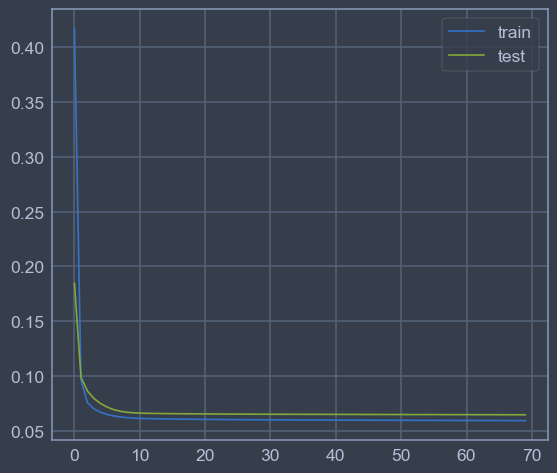

In [43]:
plt.plot(history_hours_2_layers.history['loss'], label = 'train')
plt.plot(history_hours_2_layers.history['val_loss'], label = 'test')
plt.legend(['train', 'test'])

## Making predictions

In [44]:
# test set

yhat_test = model_hours_2_layers.predict(test_X)

test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))

inv_yhat_test = np.concatenate((yhat_test, test_X[:, 1:]), axis = 1)
inv_yhat_test = scaler.inverse_transform(inv_yhat_test)
inv_yhat_test = inv_yhat_test[:, 0]

test_y = test_y.reshape(-1, 1)
inv_y_test = np.concatenate((test_y, test_X[:, 1:]), axis = 1)
inv_y_test = scaler.inverse_transform(inv_y_test)
inv_y_test = inv_y_test[:, 0]

rmse_test = mean_squared_error(inv_y_test, inv_yhat_test, squared = False)
print('Test RMSE: {:.3f}'.format(rmse_test))

# train set
yhat_train = model_hours_2_layers.predict(train_X)

train_X = train_X.reshape((train_X.shape[0], train_X.shape[2]))

inv_yhat_train = np.concatenate((yhat_train, train_X[:, 1:]), axis = 1)
inv_yhat_train = scaler.inverse_transform(inv_yhat_train)
inv_yhat_train = inv_yhat_train[:, 0]

train_y = train_y.reshape(-1, 1)
inv_y_train = np.concatenate((train_y, train_X[:, 1:]), axis = 1)
inv_y_train = scaler.inverse_transform(inv_y_train)
inv_y_train = inv_y_train[:, 0]

rmse_train = mean_squared_error(inv_y_train, inv_yhat_train, squared = False)
print('Test RMSE: {:.3f}'.format(rmse_train))

548/548 [==============================] - 1s 1ms/step
Test RMSE: 1503.707
822/822 [==============================] - 1s 1ms/step
Test RMSE: 1450.779


## Residual plot

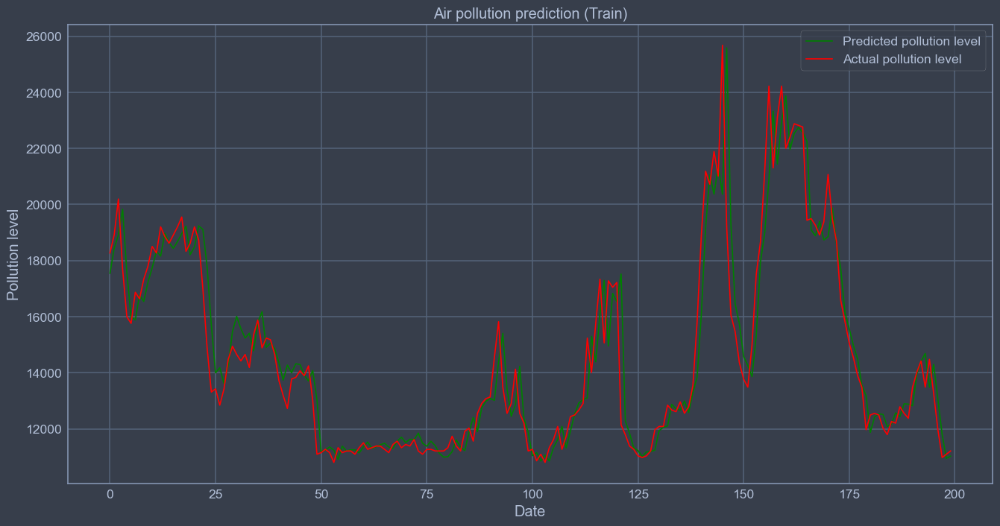

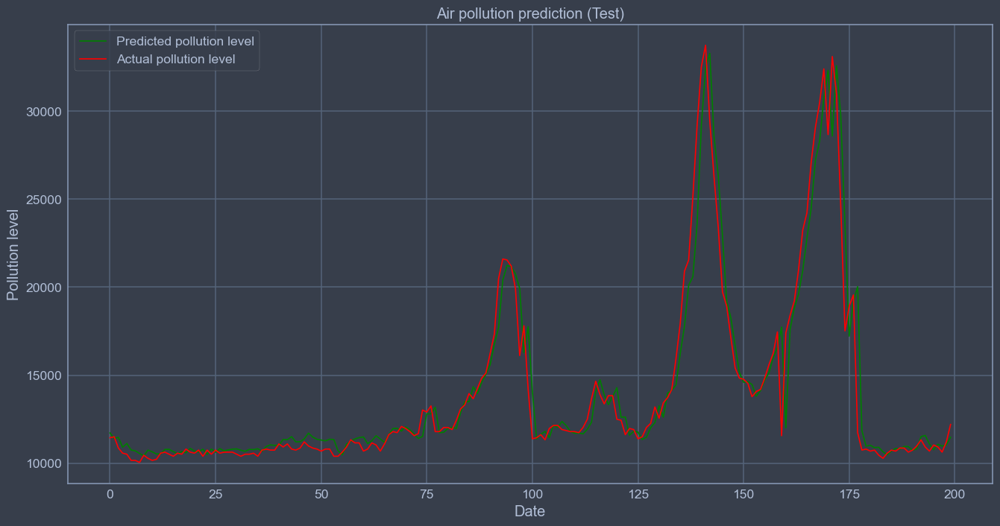

In [45]:
#train
y_train = inv_y_train.reshape(-1, 1)
y_pred_train = inv_yhat_train.reshape(-1, 1)

plt.figure(figsize = (16, 8))
plt.plot(y_pred_train[:200, :], color = 'green', label = 'Predicted pollution level')
plt.plot(y_train[:200, :], color = 'red', label = 'Actual pollution level')
plt.title('Air pollution prediction (Train)')
plt.xlabel('Date')
plt.ylabel('Pollution level')
plt.legend()
plt.show()

#test
y_test = inv_y_test.reshape(-1, 1)
y_pred_test = inv_yhat_test.reshape(-1, 1)

plt.figure(figsize = (16, 8))
plt.plot(y_pred_test[:200, :], color = 'green', label = 'Predicted pollution level')
plt.plot(y_test[:200, :], color = 'red', label = 'Actual pollution level')
plt.title('Air pollution prediction (Test)')
plt.xlabel('Date')
plt.ylabel('Pollution level')
plt.legend()
plt.show()

## R2 Score

In [46]:
print('****Train****')
print('R2 score: {}'.format(r2_score(inv_y_train, inv_yhat_train)))

print('****Test****')
print('R2 score: {}'.format(r2_score(inv_y_test, inv_yhat_test)))

****Train****
R2 score: 0.9164165076182575
****Test****
R2 score: 0.9269054704637754


#  Saving the model 


In [47]:
model_hours_2_layers = model_hours_2_layers.to_json()
with open('model_hours_2_layers.json', 'w') as json_file:
    json_file.write(model_hours_2_layers)

#  Train RNN Model with 4 hidden layers 

In [48]:
train = data_transformed.values[:(365 * 24 * 3)]
test = data_transformed.values[(365 * 24 * 3):]

train_X, train_y = train[:, :-1], train[:, -1]
test_X, test_y = test[:, :-1], test[:, -1]

train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))

train_X.shape, train_y.shape, test_X.shape, test_y.shape

((26280, 1, 8), (26280,), (17519, 1, 8), (17519,))

## Callbacks

In [49]:
checkpoint = ModelCheckpoint(
    filepath = './base/model_hours_4_layers_weights.h5py',
    monitor = 'val_loss',
    verbose = 1,
    save_best_only = True,
    mode = 'min',
    save_weights_only = True,
    save_freq = 'epoch'
)

earlyStop = EarlyStopping(
    monitor = 'val_loss',
    min_delta = 0.001,
    patience = 50,
    verbose = 1,
    mode = 'min'
)

callbacks = [checkpoint, earlyStop]

In [50]:
model_hours_4_layers = Sequential([
    LSTM(10, return_sequences = False, input_shape = (train_X.shape[1], train_X.shape[2])),
    Dropout(0.3),
    #LSTM(100, return_sequences = True),
    #Dropout(0.3),
    #LSTM(100, return_sequences = True),
    #Dropout(0.3),
    #LSTM(100),
    Dense(1)
])

model_hours_4_layers.compile(loss = 'mean_squared_error', optimizer = 'adam')
history_hours_4_layers = model_hours_4_layers.fit(
    train_X,
    train_y,
    epochs = 100,
    batch_size = 30,
    validation_data = (test_X, test_y),
    verbose = 1,
    callbacks = callbacks,
    shuffle = False ### IMPORTANT: We can not loose the time sequence,
    
)

Epoch 1/100
872/876 [============================>.] - ETA: 0s - loss: 0.4145
Epoch 1: val_loss improved from inf to 0.15900, saving model to ./base\model_hours_4_layers_weights.h5py
876/876 [==============================] - 4s 4ms/step - loss: 0.4131 - val_loss: 0.1590
Epoch 2/100
865/876 [============================>.] - ETA: 0s - loss: 0.1235
Epoch 2: val_loss improved from 0.15900 to 0.09539, saving model to ./base\model_hours_4_layers_weights.h5py
876/876 [==============================] - 3s 3ms/step - loss: 0.1230 - val_loss: 0.0954
Epoch 3/100
858/876 [============================>.] - ETA: 0s - loss: 0.1083
Epoch 3: val_loss improved from 0.09539 to 0.08742, saving model to ./base\model_hours_4_layers_weights.h5py
876/876 [==============================] - 3s 3ms/step - loss: 0.1082 - val_loss: 0.0874
Epoch 4/100
868/876 [============================>.] - ETA: 0s - loss: 0.1021
Epoch 4: val_loss improved from 0.08742 to 0.08228, saving model to ./base\model_hours_4_layers_we

853/876 [============================>.] - ETA: 0s - loss: 0.0928
Epoch 34: val_loss did not improve from 0.07052
876/876 [==============================] - 3s 3ms/step - loss: 0.0923 - val_loss: 0.0713
Epoch 35/100
857/876 [============================>.] - ETA: 0s - loss: 0.0907
Epoch 35: val_loss improved from 0.07052 to 0.07010, saving model to ./base\model_hours_4_layers_weights.h5py
876/876 [==============================] - 3s 3ms/step - loss: 0.0905 - val_loss: 0.0701
Epoch 36/100
866/876 [============================>.] - ETA: 0s - loss: 0.0917
Epoch 36: val_loss improved from 0.07010 to 0.06987, saving model to ./base\model_hours_4_layers_weights.h5py
876/876 [==============================] - 3s 3ms/step - loss: 0.0915 - val_loss: 0.0699
Epoch 37/100
857/876 [============================>.] - ETA: 0s - loss: 0.0914
Epoch 37: val_loss did not improve from 0.06987
876/876 [==============================] - 3s 3ms/step - loss: 0.0914 - val_loss: 0.0710
Epoch 38/100
857/876 [===

876/876 [==============================] - 3s 3ms/step - loss: 0.0917 - val_loss: 0.0723
Epoch 71/100
876/876 [==============================] - ETA: 0s - loss: 0.0915
Epoch 71: val_loss did not improve from 0.06899
876/876 [==============================] - 3s 3ms/step - loss: 0.0915 - val_loss: 0.0700
Epoch 72/100
870/876 [============================>.] - ETA: 0s - loss: 0.0910
Epoch 72: val_loss did not improve from 0.06899
876/876 [==============================] - 3s 3ms/step - loss: 0.0907 - val_loss: 0.0701
Epoch 73/100
861/876 [============================>.] - ETA: 0s - loss: 0.0913
Epoch 73: val_loss did not improve from 0.06899
876/876 [==============================] - 3s 3ms/step - loss: 0.0912 - val_loss: 0.0703
Epoch 74/100
861/876 [============================>.] - ETA: 0s - loss: 0.0898
Epoch 74: val_loss did not improve from 0.06899
876/876 [==============================] - 3s 3ms/step - loss: 0.0899 - val_loss: 0.0727
Epoch 75/100
860/876 [=========================

# ========================= Result analysis =========================

## Loss plot

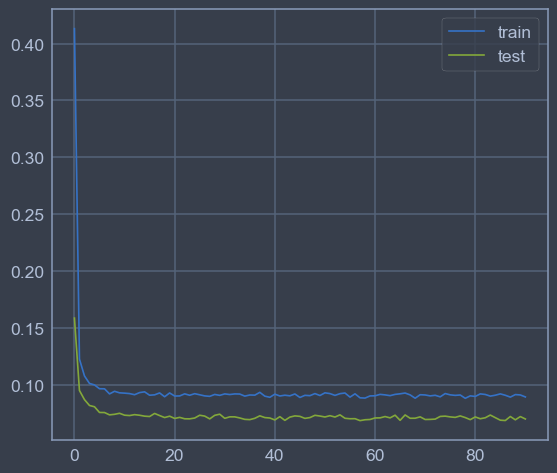

In [51]:
plt.plot(history_hours_4_layers.history['loss'], label = 'train')
plt.plot(history_hours_4_layers.history['val_loss'], label = 'test')
plt.legend(['train', 'test'])

## Making predictions

In [52]:
# test set
yhat_test = model_hours_4_layers.predict(test_X)

test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))

inv_yhat_test = np.concatenate((yhat_test, test_X[:, 1:]), axis = 1)
inv_yhat_test = scaler.inverse_transform(inv_yhat_test)
inv_yhat_test = inv_yhat_test[:, 0]

test_y = test_y.reshape(-1, 1)
inv_y_test = np.concatenate((test_y, test_X[:, 1:]), axis = 1)
inv_y_test = scaler.inverse_transform(inv_y_test)
inv_y_test = inv_y_test[:, 0]

rmse_test = mean_squared_error(inv_y_test, inv_yhat_test, squared = False)
print('Test RMSE: {:.3f}'.format(rmse_test))

# train set
yhat_train = model_hours_4_layers.predict(train_X)

train_X = train_X.reshape((train_X.shape[0], train_X.shape[2]))

inv_yhat_train = np.concatenate((yhat_train, train_X[:, 1:]), axis = 1)
inv_yhat_train = scaler.inverse_transform(inv_yhat_train)
inv_yhat_train = inv_yhat_train[:, 0]

train_y = train_y.reshape(-1, 1)
inv_y_train = np.concatenate((train_y, train_X[:, 1:]), axis = 1)
inv_y_train = scaler.inverse_transform(inv_y_train)
inv_y_train = inv_y_train[:, 0]

rmse_train = mean_squared_error(inv_y_train, inv_yhat_train, squared = False)
print('Test RMSE: {:.3f}'.format(rmse_train))

548/548 [==============================] - 1s 974us/step
Test RMSE: 1567.424
822/822 [==============================] - 1s 1ms/step
Test RMSE: 1516.928


## Residual plot

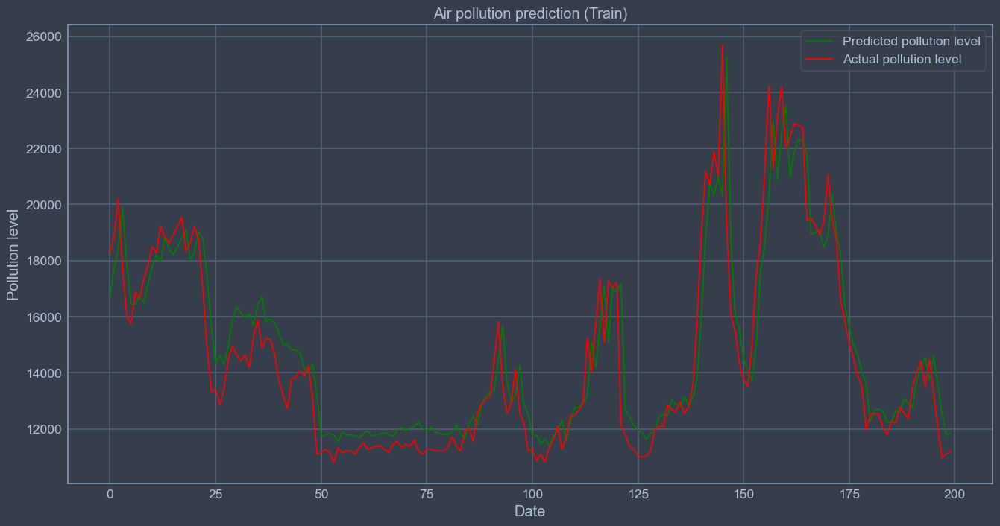

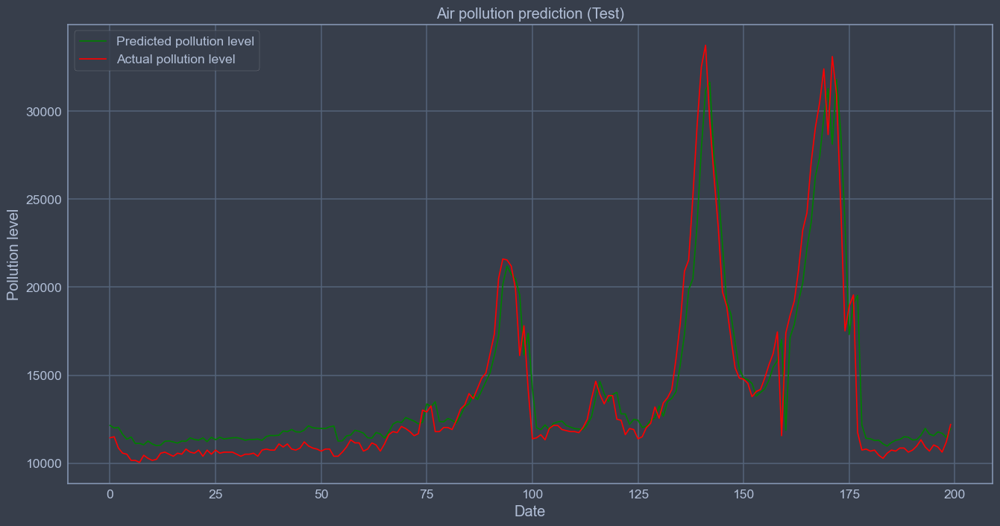

In [53]:
#train
y_train = inv_y_train.reshape(-1, 1)
y_pred_train = inv_yhat_train.reshape(-1, 1)

plt.figure(figsize = (16, 8))
plt.plot(y_pred_train[:200, :], color = 'green', label = 'Predicted pollution level')
plt.plot(y_train[:200, :], color = 'red', label = 'Actual pollution level')
plt.title('Air pollution prediction (Train)')
plt.xlabel('Date')
plt.ylabel('Pollution level')
plt.legend()
plt.show()

#test
y_test = inv_y_test.reshape(-1, 1)

y_pred_test = inv_yhat_test.reshape(-1, 1)

plt.figure(figsize = (16, 8))
plt.plot(y_pred_test[:200, :], color = 'green', label = 'Predicted pollution level')
plt.plot(y_test[:200, :], color = 'red', label = 'Actual pollution level')
plt.title('Air pollution prediction (Test)')
plt.xlabel('Date')
plt.ylabel('Pollution level')
plt.legend()
plt.show()

## R2 Score

In [54]:
print('****Train****')
print('R2 score: {}'.format(r2_score(inv_y_train, inv_yhat_train)))

print('****Test****')
print('R2 score: {}'.format(r2_score(inv_y_test, inv_yhat_test)))

****Train****
R2 score: 0.9086207892214844
****Test****
R2 score: 0.9205797587253562


#  Saving the model 

In [55]:
model_hours_4_layers = model_hours_4_layers.to_json()
with open('model_hours_4_layers.json', 'w') as json_file:
    json_file.write(model_hours_4_layers)

#  STEP 7: Making predictions for tommorow 

## Preparing Data

In [56]:
data_t = preprocessor.fit_transform(data)

data_transformed_days = pd.DataFrame(data_t)
data_transformed_days
data_transformed_days.columns = ['Wind_direction', 'Pollution', 'Dew_point', 'Temprerature', 'Pressure', 'Wind_speed', 'Snow', 'Rain']
data_transformed_days.index = data.index
data_transformed_days

,Wind_direction,Pollution,Dew_point,Temprerature,Pressure,Wind_speed,Snow,Rain
Date,,,,,,,,
2010-01-02 00:00:00,15290.0,129.0,-16.0,-4.0,1020.0,1.79,0.0,0.0
2010-01-02 01:00:00,15290.0,148.0,-15.0,-4.0,1020.0,2.68,0.0,0.0
2010-01-02 02:00:00,15290.0,159.0,-11.0,-5.0,1021.0,3.57,0.0,0.0
2010-01-02 03:00:00,15290.0,181.0,-7.0,-5.0,1022.0,5.36,1.0,0.0
2010-01-02 04:00:00,15290.0,138.0,-7.0,-5.0,1022.0,6.25,2.0,0.0
...,...,...,...,...,...,...,...,...
2014-12-31 19:00:00,14130.0,8.0,-23.0,-2.0,1034.0,231.97,0.0,0.0
2014-12-31 20:00:00,14130.0,10.0,-22.0,-3.0,1034.0,237.78,0.0,0.0
2014-12-31 21:00:00,14130.0,10.0,-22.0,-3.0,1034.0,242.70,0.0,0.0


## Creating new features

In [57]:
mean_pollution = []
mean_dew_point = []
mean_temperature = []
mean_pressure = []
mean_wind_speed = []
amount_of_snow = []
amount_of_rain = []


for i in range(int(data_transformed_days.shape[0] / 24)):
    pollution = []
    dew_point = []
    temperature = []
    pressure = []
    wind_speed = []
    snow = []
    rain = []
    
    for row in data_transformed_days.iloc[(i*24):((i+1)*24), :].itertuples():
        pollution.append(row.Pollution)
        dew_point.append(row.Dew_point)
        temperature.append(row.Temprerature)
        pressure.append(row.Pressure)
        wind_speed.append(row.Wind_speed)
        snow.append(row.Snow)
        rain.append(row.Rain)
        
    mean_pollution.append(np.mean(pollution))
    mean_dew_point.append(np.mean(dew_point))
    mean_temperature.append(np.mean(temperature))
    mean_pressure.append(np.mean(pressure))
    mean_wind_speed.append(np.mean(wind_speed))
    amount_of_snow.append(np.sum(snow))
    amount_of_rain.append(np.sum(rain))

## Slicing dataset to days

In [58]:
data_transformed_days = data_transformed_days.iloc[::24, :]
data_transformed_days

,Wind_direction,Pollution,Dew_point,Temprerature,Pressure,Wind_speed,Snow,Rain
Date,,,,,,,,
2010-01-02,15290.0,129.0,-16.0,-4.0,1020.0,1.79,0.0,0.0
2010-01-03,15290.0,90.0,-7.0,-6.0,1027.0,58.56,4.0,0.0
2010-01-04,14130.0,79.0,-14.0,-12.0,1023.0,16.09,0.0,0.0
2010-01-05,14130.0,30.0,-26.0,-17.0,1035.0,201.58,0.0,0.0
2010-01-06,14130.0,56.0,-25.0,-17.0,1033.0,26.83,0.0,0.0
...,...,...,...,...,...,...,...,...
2014-12-27,14130.0,163.0,-10.0,-5.0,1030.0,1.79,0.0,0.0
2014-12-28,9384.0,385.0,-9.0,-6.0,1025.0,6.69,0.0,0.0
2014-12-29,9384.0,362.0,-10.0,-4.0,1016.0,4.01,0.0,0.0


In [59]:
# adding new features
data_transformed_days['Mean_pollution'] = mean_pollution
data_transformed_days['Mean_dew_point'] = mean_dew_point
data_transformed_days['Mean_temperature'] = mean_temperature
data_transformed_days['Mean_pressure'] = mean_pressure
data_transformed_days['Mean_wind_speed'] = mean_wind_speed
data_transformed_days['Amount_of_snow'] = amount_of_snow
data_transformed_days['Amount_of_rain'] = amount_of_rain

# dropping old features
data_transformed_days.drop(labels = ['Pollution', 'Dew_point', 'Temprerature', 'Pressure', 'Wind_speed', 'Snow', 'Rain'], axis = 1, inplace = True)

## Scaling

In [60]:
### scaler = MinMaxScaler()
data_transformed_days_t = scaler.fit_transform(data_transformed_days.drop('Mean_pollution', axis = 1))
data_transformed_days_t = pd.DataFrame(data_transformed_days_t)
data_transformed_days_t.columns = data_transformed_days.drop('Mean_pollution', axis = 1).columns
data_transformed_days_t.index = data_transformed_days.drop('Mean_pollution', axis = 1).index
data_transformed_days_t

,Wind_direction,Mean_dew_point,Mean_temperature,Mean_pressure,Mean_wind_speed,Amount_of_snow,Amount_of_rain
Date,,,,,,,
2010-01-02,0.19641,-0.418874,-0.880539,0.513784,0.851533,17.0,0.0
2010-01-03,0.19641,-0.483444,-1.038536,0.395990,3.673062,340.0,0.0
2010-01-04,0.00000,-0.910596,-1.175337,0.786967,6.136067,0.0,0.0
2010-01-05,0.00000,-1.057947,-1.312139,1.047619,2.814691,0.0,0.0
2010-01-06,0.00000,-1.023179,-1.223507,1.055138,0.462800,0.0,0.0
...,...,...,...,...,...,...,...
2014-12-27,0.00000,-0.465232,-0.726397,0.699248,-0.102592,0.0,0.0
2014-12-28,-0.80359,-0.509934,-0.570328,0.225564,-0.000306,0.0,0.0
2014-12-29,-0.80359,-0.571192,-0.608863,-0.147870,-0.180870,0.0,0.0


## Descritizing the target

In [61]:
quantiles = data_transformed_days['Mean_pollution'].quantile([0, 0.25, 0.5, 0.75, 1])

In [62]:
quantiles

0.00      2.958333
0.25     44.333333
0.50     81.833333
0.75    127.625000
1.00    533.567217
Name: Mean_pollution, dtype: float64

    We will descritize the pollution level and turn into binary. 

In [63]:
data_transformed_days_t['Mean_pollution_discretize'] = pd.cut(
    x = data_transformed_days['Mean_pollution'],
    bins = list(quantiles.values), 
    labels = [1, 2, 3, 4]
)

## Creating the predicted pollution for next day

In [64]:
data_transformed_days_t['Predicted_pollution_discretize'] = data_transformed_days_t['Mean_pollution_discretize'].shift(-1)
data_transformed_days_t

,Wind_direction,Mean_dew_point,Mean_temperature,Mean_pressure,Mean_wind_speed,Amount_of_snow,Amount_of_rain,Mean_pollution_discretize,Predicted_pollution_discretize
Date,,,,,,,,,
2010-01-02,0.19641,-0.418874,-0.880539,0.513784,0.851533,17.0,0.0,4,2
2010-01-03,0.19641,-0.483444,-1.038536,0.395990,3.673062,340.0,0.0,2,1
2010-01-04,0.00000,-0.910596,-1.175337,0.786967,6.136067,0.0,0.0,1,1
2010-01-05,0.00000,-1.057947,-1.312139,1.047619,2.814691,0.0,0.0,1,2
2010-01-06,0.00000,-1.023179,-1.223507,1.055138,0.462800,0.0,0.0,2,2
...,...,...,...,...,...,...,...,...,...
2014-12-27,0.00000,-0.465232,-0.726397,0.699248,-0.102592,0.0,0.0,4,4
2014-12-28,-0.80359,-0.509934,-0.570328,0.225564,-0.000306,0.0,0.0,4,4
2014-12-29,-0.80359,-0.571192,-0.608863,-0.147870,-0.180870,0.0,0.0,4,2


In [65]:
data_transformed_days_t.drop(data_transformed_days_t.tail(1).index, inplace = True)
data_transformed_days_t.tail()

,Wind_direction,Mean_dew_point,Mean_temperature,Mean_pressure,Mean_wind_speed,Amount_of_snow,Amount_of_rain,Mean_pollution_discretize,Predicted_pollution_discretize
Date,,,,,,,,,
2014-12-26,0.19641,-0.461921,-0.772640,0.932331,-0.545670,0.0,0.0,4,4
2014-12-27,0.00000,-0.465232,-0.726397,0.699248,-0.102592,0.0,0.0,4,4
2014-12-28,-0.80359,-0.509934,-0.570328,0.225564,-0.000306,0.0,0.0,4,4
2014-12-29,-0.80359,-0.571192,-0.608863,-0.147870,-0.180870,0.0,0.0,4,2
2014-12-30,-0.80359,-0.634106,-0.556840,0.175439,-0.071975,0.0,0.0,2,1


## Spliting to train / test sets

In [66]:
train_days = data_transformed_days_t.values[:(365 * 4)]
test_days = data_transformed_days_t.values[(365 * 4):]

train_X_days, train_y_days = train_days[:, :-1], train_days[:, -1]
test_X_days, test_y_days = test_days[:, :-1], test_days[:, -1]

train_X_days = train_X_days.reshape((train_X_days.shape[0], 1, train_X_days.shape[1]))
test_X_days = test_X_days.reshape((test_X_days.shape[0], 1, test_X_days.shape[1]))

train_X_days.shape, train_y_days.shape, test_X_days.shape, test_y_days.shape

((1460, 1, 8), (1460,), (364, 1, 8), (364,))

## Callbacks

In [67]:
checkpoint = ModelCheckpoint(
    filepath = './base/model_RNN_days_weights.h5py',
    monitor = 'val_loss',
    verbose = 1,
    save_best_only = True,
    mode = 'min',
    save_weights_only = True,
    save_freq = 'epoch'
)

earlyStop = EarlyStopping(
    monitor = 'val_loss',
    min_delta = 0.0001,
    patience = 50,
    verbose = 1,
    mode = 'min'
)

callbacks = [checkpoint, earlyStop]

#  Train RNN Model with 2 hidden layers 

In [68]:
model_hours_4_layers = Sequential([
    LSTM(10, return_sequences = False, input_shape = (train_X.shape[1], train_X.shape[2])),
    Dropout(0.3),
    #LSTM(100, return_sequences = True),
    #Dropout(0.3),
    #LSTM(100, return_sequences = True),
    #Dropout(0.3),
    #LSTM(100),
    Dense(1)
])

model_hours_4_layers.compile(loss = 'mean_squared_error', optimizer = 'adam')
history_hours_4_layers = model_hours_4_layers.fit(
    train_X,
    train_y,
    epochs = 100,
    batch_size = 30,
    validation_data = (test_X, test_y),
    verbose = 1,
    callbacks = callbacks,
    shuffle = False ### IMPORTANT: We can not loose the time sequence,
    
)

IndexError: tuple index out of range

model_days = Sequential([
    LSTM(100, return_sequences = False, input_shape = (train_X_days.shape[1], train_X_days.shape[2])),
    Dense(1)
])

model_days.compile(loss = 'mean_squared_error', optimizer = 'adam')
history_days = model_days.fit(
    train_X_days,
    train_y_days,
    epochs = 100,
    batch_size = 20,
    validation_data = (test_X_days, test_y_days),
    verbose = 1,
    callbacks = callbacks,
    shuffle = False
)


#  Result analysis 

## Loss plot

In [ ]:
plt.plot(history_days.history['loss'], label = 'train')
plt.plot(history_days.history['val_loss'], label = 'test')
plt.legend(['train', 'test'])

## Making predictions

In [ ]:
# train set
yhat_train = model_days.predict(train_X_days)

train_X_days = train_X_days.reshape((train_X_days.shape[0], train_X_days.shape[2]))

inv_yhat_train = np.concatenate((yhat_train, train_X_days[:, 1:]), axis = 1)
inv_yhat_train = scaler.inverse_transform(inv_yhat_train)
inv_yhat_train = inv_yhat_train[:, 0]

train_y_days = train_y_days.reshape(-1, 1)
inv_y_train = np.concatenate((train_y_days, train_X_days[:, 1:]), axis = 1)
inv_y_train = scaler.inverse_transform(inv_y_train)
inv_y_train = inv_y_train[:, 0]

rmse_train = mean_squared_error(inv_y_train, inv_yhat_train, squared = False)
print('Train RMSE: {:.3f}'.format(rmse_train))

# test set
yhat_test = model_days.predict(test_X_days)

test_X_days = test_X_days.reshape((test_X_days.shape[0], test_X_days.shape[2]))

inv_yhat_test = np.concatenate((yhat_test, test_X_days[:, 1:]), axis = 1)
inv_yhat_test = scaler.inverse_transform(inv_yhat_test)
inv_yhat_test = inv_yhat_test[:, 0]

test_y_days = test_y_days.reshape(-1, 1)
inv_y_test = np.concatenate((test_y_days, test_X_days[:, 1:]), axis = 1)
inv_y_test = scaler.inverse_transform(inv_y_test)
inv_y_test = inv_y_test[:, 0]

rmse_test = mean_squared_error(inv_y_test, inv_yhat_test, squared = False)
print('Test RMSE: {:.3f}'.format(rmse_test))

In [ ]:
#train
y_train_days = inv_y_train.reshape(-1, 1)
y_pred_train = inv_yhat_train.reshape(-1, 1)

plt.figure(figsize = (16, 8))
plt.plot(y_pred_train[:200, :], color = 'green', label = 'Predicted pollution level')
plt.plot(y_train_days[:200, :], color = 'red', label = 'Actual pollution level')
plt.title('Air pollution prediction (Train)')
plt.xlabel('Date')
plt.ylabel('Pollution level')
plt.legend()
plt.show()

#test
y_test_days = inv_y_test.reshape(-1, 1)
y_pred_test = inv_yhat_test.reshape(-1, 1)

plt.figure(figsize = (16, 8))
plt.plot(y_pred_test[:200, :], color = 'green', label = 'Predicted pollution level')
plt.plot(y_test_days[:200, :], color = 'red', label = 'Actual pollution level')
plt.title('Air pollution prediction (Test)')
plt.xlabel('Date')
plt.ylabel('Pollution level')
plt.legend()
plt.show()

## R2 Score

In [ ]:
print('****Train****')
print('R2 score: {}'.format(r2_score(inv_y_train, inv_yhat_train)))

print('****Test****')
print('R2 score: {}'.format(r2_score(inv_y_test, inv_yhat_test)))

#  Saving the model 

In [ ]:
model_RNN_days = model_days.to_json()
with open('model_RNN_days.json', 'w') as json_file:
    json_file.write(model_RNN_days)

#  STEP 8: Coclusion 

##  Data Analysis

    After completing the data analysis step, we found several insights. 

        1. the imoprtant facotrs for dropping the air pollution is 

            1. Temperature
            2. Rain / snow
            3. Wind speed
       

        2. In 2010 and 2013 the pollution rates were the highest. 
        
            I suppose that dispite the fact that the rain, snow and wind rates were the highest during the 2010, the temperature was the lowest. and the government was not ready for that
            in Regard of 2013, the amount of Rain, Snow and Wind during that year was significantly low.

            
        3. During the first two years of the report, the most polluted season was Fall, While from 2012 to 2014, the most polluted season has changed to Winter.

       
        4. Summer was the least polluted season during all 5 years.

            It is because of the rain season in China and high temperature during that season.

       
        5. The most polluted months were usually February or January

        
        6. 2012 year was least polluted year, having the smallest mean pollution rate

            I suppose it is because the rain, snow, wind and temperature were relatively high during that year

            
        I suppose year by year the government tries to overcome the problem with air pollution.   

      
               
   ## Training & Evaluating ANN

        > For predicting the pollution rate for the next hour:

            1. The RNN model with 2 LSTM layers (100 neurons each) performs well showing the 91% r2 score at test set and 90% at train set without any sign of overfitting. 

                It can be seen by the residual plot that the RNN model predicts well for the small as well as for the high values of Pollution rate with the minimum rate of error. 

                
            2. The RNN model with 4 LSTM layers (100 neurons each) + 3 Dropout layers (0.3) performs well showing the 90% r2 score at test set and 88% at train set without any sign of overfitting. 

                It can be seen by the residual plot that the RNN model predicts well for the small as well as for the high values of pollution rate with the minimum rate of error. 

                
            3. It seems that the first model with 2 LSTM layers (100 neurons each) wors better in regard to both performance and the running time.

         
         > For predicting the pollution rate for the next day:

             I have trained the RNN model with 2 LSTM layers (100 neurons each) performs poorly showing only 35% of r2 score on train set and 36% on test set without any sign of overfitting. 
         
             It can be seen by the residual plot that the RNN model predicts poorly the high rates of pollution (>= 8000) Having huge residuals (>= 3000). However, it can also be seen that if the pollution rate is low (< 8000), the model predicts the pollution rate relatevely okay with relativelly low residuals (<= 1000).

                                

    I can conlude that its better to use Model with less LSTM layers to predict the Pollution rate for next hour due to the better performance, lower residuals and better training time.
    
    I suppose that predicting Pollution rate for the next day is still complicated task and more steps and techniques should be applied to boost the performance.
    
    However I think that the model is passible in predicting the low Pollution rate (<8000).

                           

# THANKS FOR YOUR ATTENTION!